# Exploring SwissLipids from a network perspective

## Loading dependencies and data

In [1]:
from lipinet.parse_swisslipids import parse_swisslipids_data

sl_results = parse_swisslipids_data(verbose=False)
df_sl_nodes = sl_results['df_nodes']
df_sl_edges = sl_results['df_edges'] 

In [2]:
from graph_tool.all import Graph, GraphView, graph_draw
import graph_tool as gt

import onionnet
from onionnet import OnionNet
import onionnet.visualisation

import pandas as pd

## Building the network with OnionNet

In [3]:
onion = OnionNet()

onion.grow_onion(df_nodes=df_sl_nodes,
           df_edges=df_sl_edges,
           node_prop_cols=df_sl_nodes.columns.to_list(),
           edge_prop_cols=df_sl_edges.columns.to_list(),
           drop_na=True,
           drop_duplicates=True)

This has built the network, with about 2.7 million nodes and around 7 million edges - within 30 seconds on a decent laptop!

In [4]:
onion.core.graph

<Graph object, directed, with 2783345 vertices and 6890979 edges, 34 internal vertex properties, 5 internal edge properties, at 0x3217ff650>

Hopefully it goes without saying that this is far too large to visualise for us at this stage. So instead we'll begin by looking at the top of the network using the Lipid entry as the root node. We can see it in the table below, with the node_id `SLM:000389145`

In [5]:
df_sl_nodes[df_sl_nodes['Level']=='Category']

,layer,node_id,Lipid ID,Level,Name,Abbreviation*,Synonyms*,Lipid class*,Parent,Components*,...,Exact m/z of [M+NH4]+,Exact m/z of [M-H]-,Exact m/z of [M+Cl]-,Exact m/z of [M+OAc]-,CHEBI,LIPID MAPS,HMDB,MetaNetX,PMID,Components_parsed
6569869,swisslipids,SLM:000000525,SLM:000000525,Category,Sphingolipids,SL,NaN,SLM:000389145,NaN,NaN,...,NaN,NaN,NaN,NaN,26739,NaN,NaN,MNXM82564,NaN,NaN
6622257,swisslipids,SLM:000001193,SLM:000001193,Category,Glycerophospholipids,GP,NaN,SLM:000389145,NaN,NaN,...,NaN,NaN,NaN,NaN,37739,NaN,NaN,MNXM55319,NaN,NaN
7681819,swisslipids,SLM:000117142,SLM:000117142,Category,Glycerolipids,GL,NaN,SLM:000389145,NaN,NaN,...,NaN,NaN,NaN,NaN,35741,NaN,NaN,MNXM55310,NaN,NaN
10570513,swisslipids,SLM:000389145,SLM:000389145,Category,Lipid,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,18059,NaN,NaN,MNXM12117,NaN,NaN
10587719,swisslipids,SLM:000390054,SLM:000390054,Category,Fatty acyls and derivatives,NaN,NaN,SLM:000389145,NaN,NaN,...,NaN,NaN,NaN,NaN,61697,NaN,NaN,MNXM512004,NaN,NaN
11503494,swisslipids,SLM:000500463,SLM:000500463,Category,Steroids and derivatives,NaN,NaN,SLM:000389145,NaN,NaN,...,NaN,NaN,NaN,NaN,35341,NaN,NaN,MNXM682861,NaN,NaN
11579041,swisslipids,SLM:000508860,SLM:000508860,Category,Prenol Lipids,NaN,NaN,SLM:000389145,NaN,NaN,...,NaN,NaN,NaN,NaN,26244,NaN,NaN,NaN,NaN,NaN


We can get all these nodes on this level and visualise in a very simple plot 

First, decode some of the graph properties to a more human readable format

In [6]:
extra_vars = ['layer', 'node_id'] #, 'Lipid ID']
for var in extra_vars:
    onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name=var
    )
# do the Lipid ID separately bc of the gaps
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='Lipid ID',
        new_prop_name='lipidid_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='Lipid class*',
        new_prop_name='lipidclass_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='Name',
        new_prop_name='name_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='Level',
        new_prop_name='level_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='CHEBI',
        new_prop_name='chebi_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='LIPID MAPS',
        new_prop_name='lipidmaps_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='v', 
        encoded_prop_name='HMDB',
        new_prop_name='hmdb_decoded'
    )
onion.prop_manager.decode_property_labels(
        encoded_prop_type='e', 
        encoded_prop_name='interlayer',
        new_prop_name='interlayer_decoded'
    )

V property 'layer_decoded' created successfully.
V property 'node_id_decoded' created successfully.
V property 'lipidid_decoded' created successfully.
V property 'lipidclass_decoded' created successfully.
V property 'name_decoded' created successfully.
V property 'level_decoded' created successfully.
V property 'chebi_decoded' created successfully.
V property 'lipidmaps_decoded' created successfully.
V property 'hmdb_decoded' created successfully.
E property 'interlayer_decoded' created successfully.


## Filtering the network

Now let's use some filtering logic to only get those with the 'Category' level

In [7]:
filter1 = lambda v: onion.core.graph.vp['level_decoded'][v] == 'Category'
filtered_view = onion.searcher.compose_filters(filter_funcs=[filter1], mode="or")
filtered_view

<GraphView object, directed, with 7 vertices and 6 edges, 43 internal vertex properties, 6 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x306b611c0, at 0x30a40ff80>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x306b611c0, at 0x11feb18b0>, False), at 0x306b611c0>

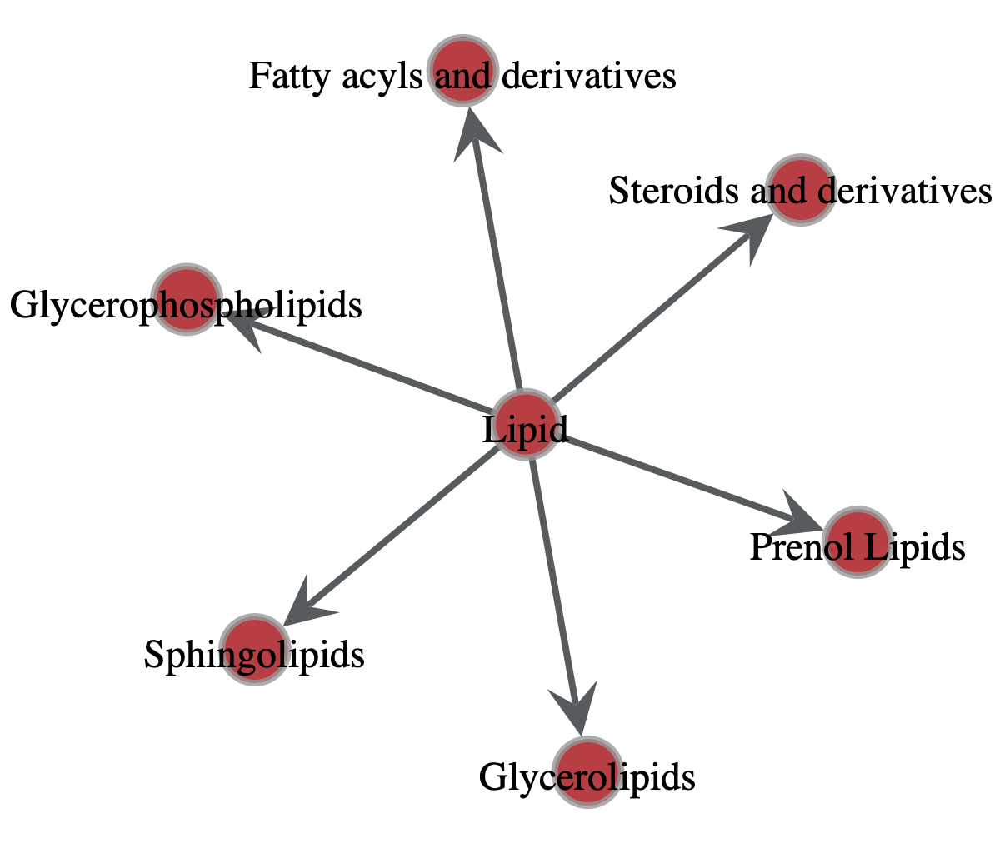

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x306b611c0, at 0x10562fd10>

In [8]:
graph_draw(
    filtered_view,
    vertex_text=filtered_view.vp['name_decoded'], 
    vertex_text_position=-2,
    vertex_size=40,
    vertex_text_color='black'
    )

Now what if we want to get those of the Class too? Here we will combine these filters to do that. This time we will also avoid printing the node names since we have so many nodes.

In [9]:
filter1 = lambda v: onion.core.graph.vp['level_decoded'][v] == 'Category'
filter2 = lambda v: onion.core.graph.vp['level_decoded'][v] == 'Class'
filtered_view = onion.compose_filters([filter1, filter2], mode="or")
filtered_view

<GraphView object, directed, with 813 vertices and 491 edges, 43 internal vertex properties, 6 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x32181f140, at 0x32181f2f0>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x32181f140, at 0x169483980>, False), at 0x32181f140>

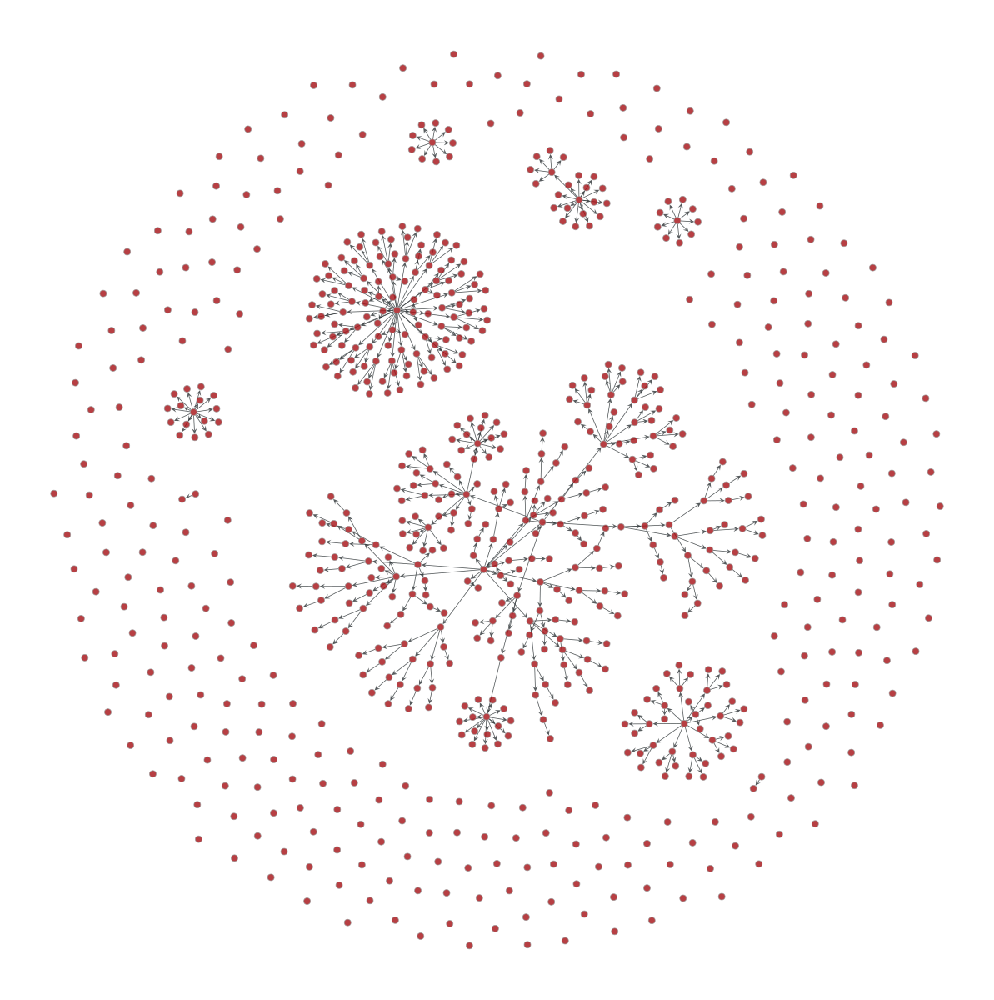

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x32181f140, at 0x43cf5ccb0>

In [10]:
graph_draw(
    filtered_view,
    vertex_size=4,
    vertex_text_color='black'
    )

As we can see, this has resulted in many disjointed parts of the network. We may have to revisit our parsing process to double check this has worked correctly.

We can inspect the network on a more granular level too. First, we will find the index of the root node for lipids, then traverse the network.

In [11]:
lipids_root_node = onion.get_vertex_by_name_tuple(layer_name='swisslipids', node_id_str='SLM:000389145')

Filtered graph contains 95 vertices and 94 edges.


/opt/anaconda3/envs/graphtool/lib/python3.12/site-packages/graph_tool/draw/cairo_draw.py:545: UserWarning: Unknown edge attribute: text_colour
  warnings.warn(f"Unknown {kind} attribute: " + str(k), UserWarning)


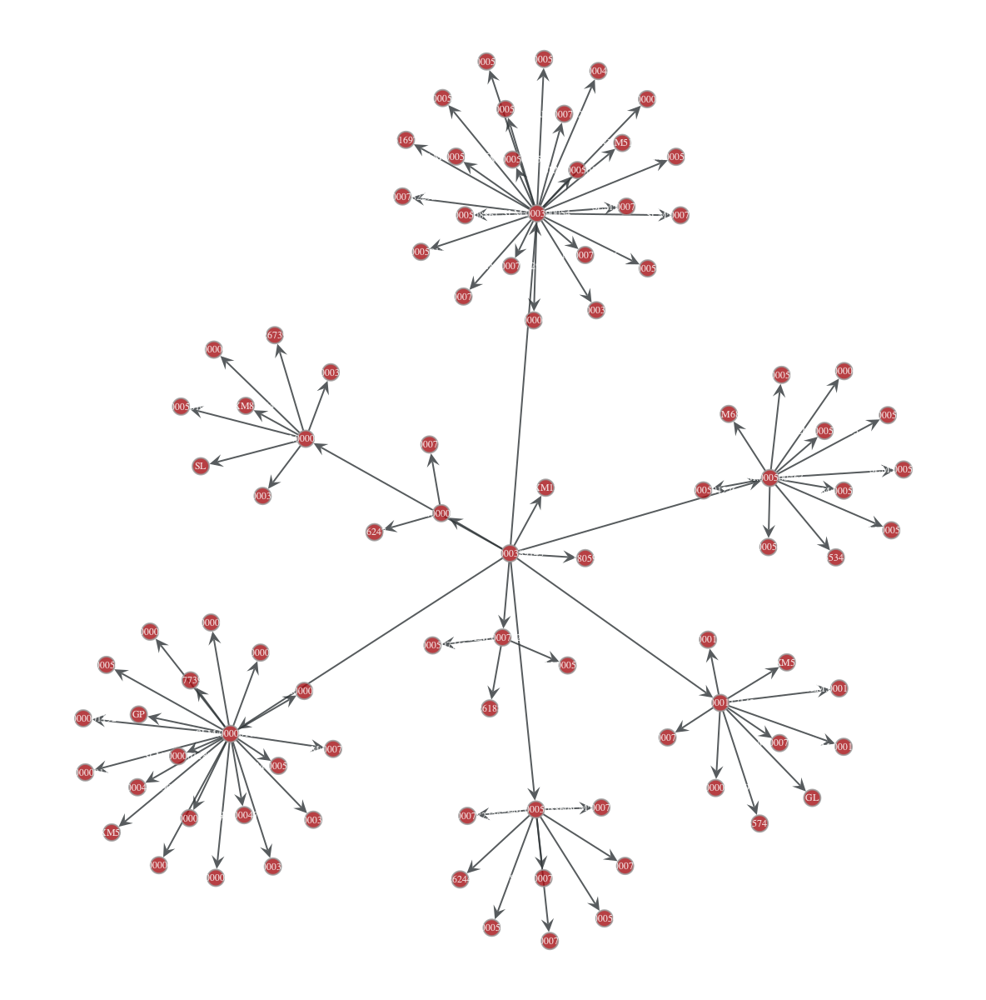

<GraphView object, directed, with 95 vertices and 94 edges, 43 internal vertex properties, 6 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x31935c860, at 0x43cf5c320>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x31935c860, at 0x43cf5c050>, False), at 0x31935c860>

In [12]:
onion.searcher.search(start_node_idx=lipids_root_node, 
                      max_dist=2, 
                      node_text_prop='node_id_decoded',
                      vertex_text_position=-2,
                      vertex_size=10,
                      vertex_text_colour='black')

We could also improve the visualisation of this network to show the different types of nodes

Also, because the swisslipid levels follow a hierarchy (https://www.swisslipids.org/#/about/lipid_hierarchy), we will specify this here directly and assign colors in a standardised manner.

In [ ]:
import matplotlib.cm as cm

sl_levels_custom_order = ['Category','Class','Species','Molecular subspecies','Structural subspecies','Isomeric subspecies','nan']
# To use tab10
# sl_levels_custom_colordict = {cat: cm.tab10(i % len(sl_levels_custom_order)) for i, cat in enumerate(sl_levels_custom_order)}
# To use paired colormap, but swap around the order so it looks a little better
# sl_levels_custom_colordict = {
#     cat: cm.Paired((i ^ 1) % len(sl_levels_custom_order))
#     for i, cat in enumerate(sl_levels_custom_order)
# }
# To use normal paired colormap but swapping class and category cols
sl_levels_custom_colordict = {cat: cm.Paired(i % len(sl_levels_custom_order)) for i, cat in enumerate(sl_levels_custom_order)}
sl_levels_custom_colordict = {**sl_levels_custom_colordict, 'Category': sl_levels_custom_colordict['Class'], 'Class': sl_levels_custom_colordict['Category']}
sl_levels_custom_colordict['nan'] = cm.Greys(0.5)

In [14]:
# Nodes
color_result = onionnet.visualisation.color_nodes(g=onion.core.graph, prop_name="level_decoded", method="categorical", generate_legend=True, custom_color_dict=sl_levels_custom_colordict)
shape_result = onionnet.visualisation.shape_nodes(g=onion.core.graph, prop_name="layer_decoded", shape_method="categorical", generate_legend=True)
halo_result  = onionnet.visualisation.add_halo_to_node(g=onion.core.graph, node=lipids_root_node)

# Edges
edges_interlayer_col = onionnet.visualisation.color_edges(g=onion.core.graph, prop_name='interlayer', method='boolean')

# Create summary dict for convenience
graphic_styles = {**color_result, **shape_result, **halo_result, **edges_interlayer_col}
graphic_styles

# Assign some of the properties that we will likely be using often back to the graph
onion.core.graph.vp['v_color_level'] = graphic_styles['v_color']
onion.core.graph.vp['v_shape_layer'] = graphic_styles['v_shape']
onion.core.graph.ep['e_color_inter'] = graphic_styles['e_color']

Filtered graph contains 95 vertices and 94 edges.


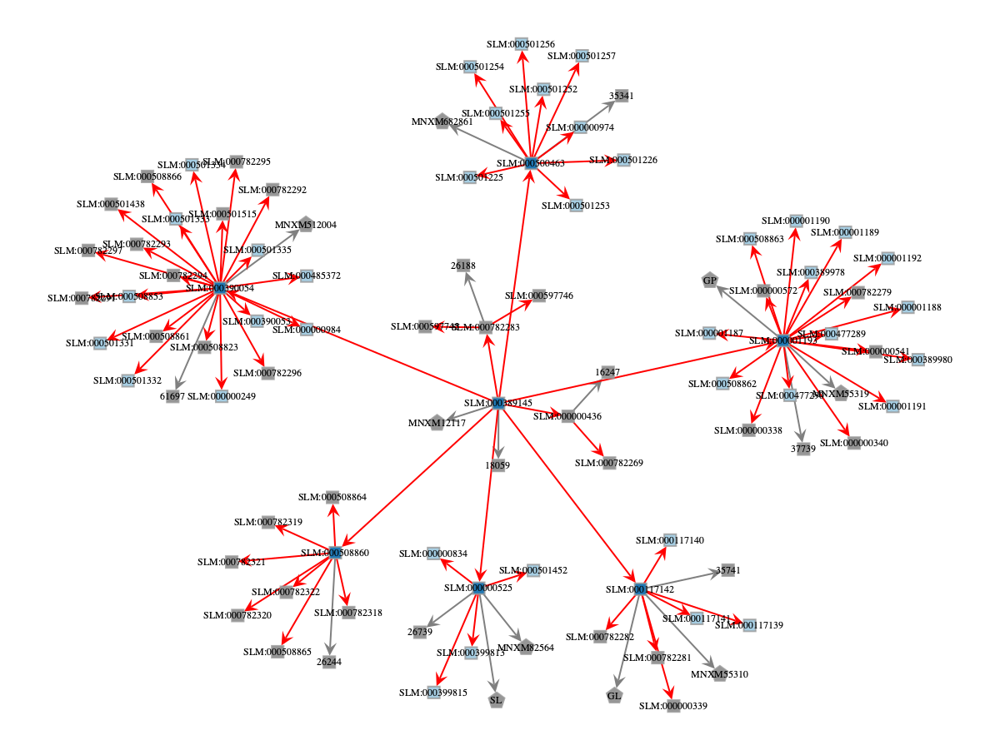

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x374a78d10, at 0x43cf5d430>

In [15]:
search_res = onion.searcher.search(start_node_idx=lipids_root_node, max_dist=2, show_plot=False)

graph_draw(search_res,
           vertex_text=search_res.vp['node_id_decoded'],
            vertex_text_position=-2,
            vertex_size=10,
            vertex_text_color='black',
            # here we add the graphics from above
            vertex_fill_color=search_res.vp['v_color_level'],
            vertex_shape=search_res.vp['v_shape_layer'],
            edge_color=search_res.ep['e_color_inter'],
)

This hints towards a problem in the SL data. If we look closely we can see that the nodes are coloured by level in the case they are swisslipids. Already we can see that many of the SL lipids do not have an assigned 'level'. This is most likely why when we used our 'Level' filter functionality earlier for the top two highest levels, these nodes were not included, and hence the resulting graph would have appeared far more disjointed than in actual fact it is.

Furthermore if we take an even closer look into some of these, we see that some of the lipids have SL identifiers and ChEBI identifiers, such as 'SLM:000000436' which is 'phospholipid'. But this also does not have a Level assigned to it, has only a single child entry, and if we take a look at the SL data online, it is not included in any of the 7 official categories below Lipids. Instead, one of the other major categories is 'Glycerophospholipids', which is a subset of it. While perhaps this may seem trivial, it suggests these kind of problems could be widespread, and they could have ramifications on how we categorise the data or link it to other resources (such as ChEBI).

Filtered graph contains 734 vertices and 749 edges.


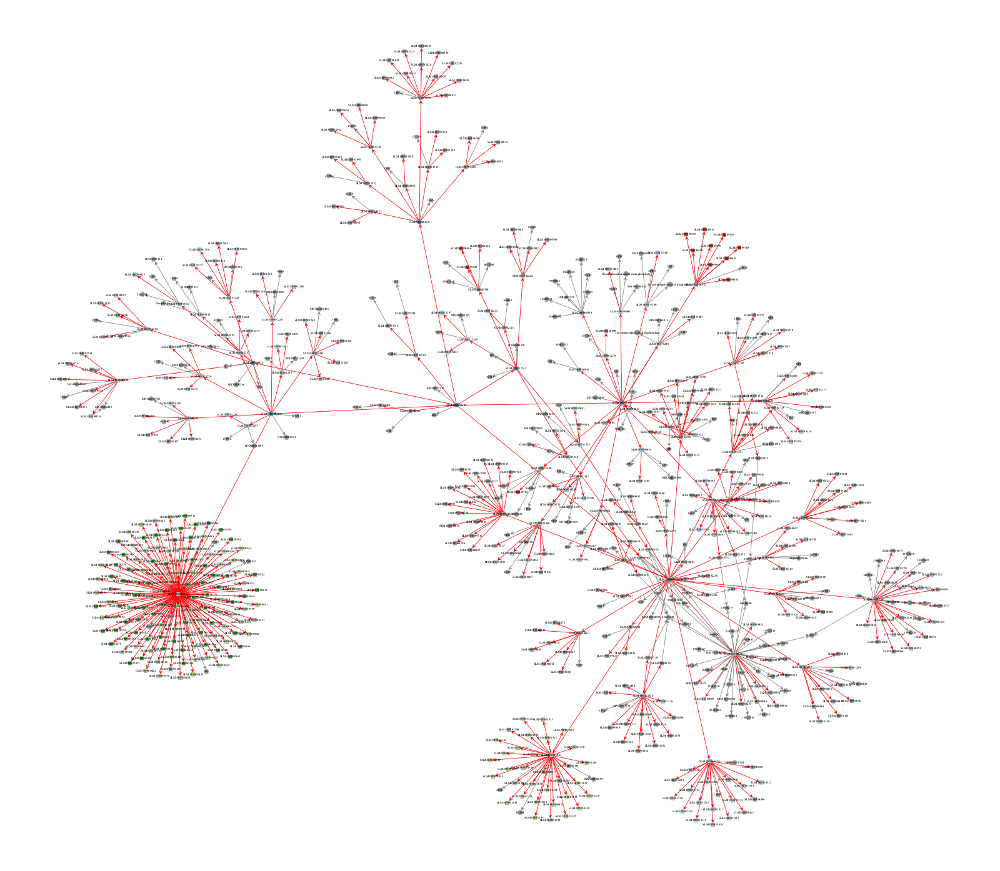

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x1050bf9e0, at 0x43cf21970>

In [16]:
search_res = onion.searcher.search(start_node_idx=lipids_root_node, max_dist=3, show_plot=False)

graph_draw(search_res,
           vertex_text=search_res.vp['node_id_decoded'],
            vertex_text_position=-2,
            vertex_size=4,
            output_size=(800,800),
            #output='testing_sl.svg',
            vertex_text_color='black',
            # here we add the graphics from above
            vertex_fill_color=search_res.vp['v_color_level'],
            vertex_shape=search_res.vp['v_shape_layer'],
            edge_color=search_res.ep['e_color_inter'],
)

## Exploring bipartite networks

### ChEBI

Now what if we want to look at how ChEBI's map to SwissLipids, and whether there are overlaps?

In [17]:
layer_1 = 'swisslipids'
layer_2 = 'sl_chebi'
gv2 = onion.create_bipartite_gv(layer1=layer_1, layer2=layer_2)
gv2

<GraphView object, directed, with 8555 vertices and 4279 edges, 45 internal vertex properties, 7 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x4a39fc590, at 0x43cf236e0>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x4a39fc590, at 0x3217b9c40>, False), at 0x4a39fc590>

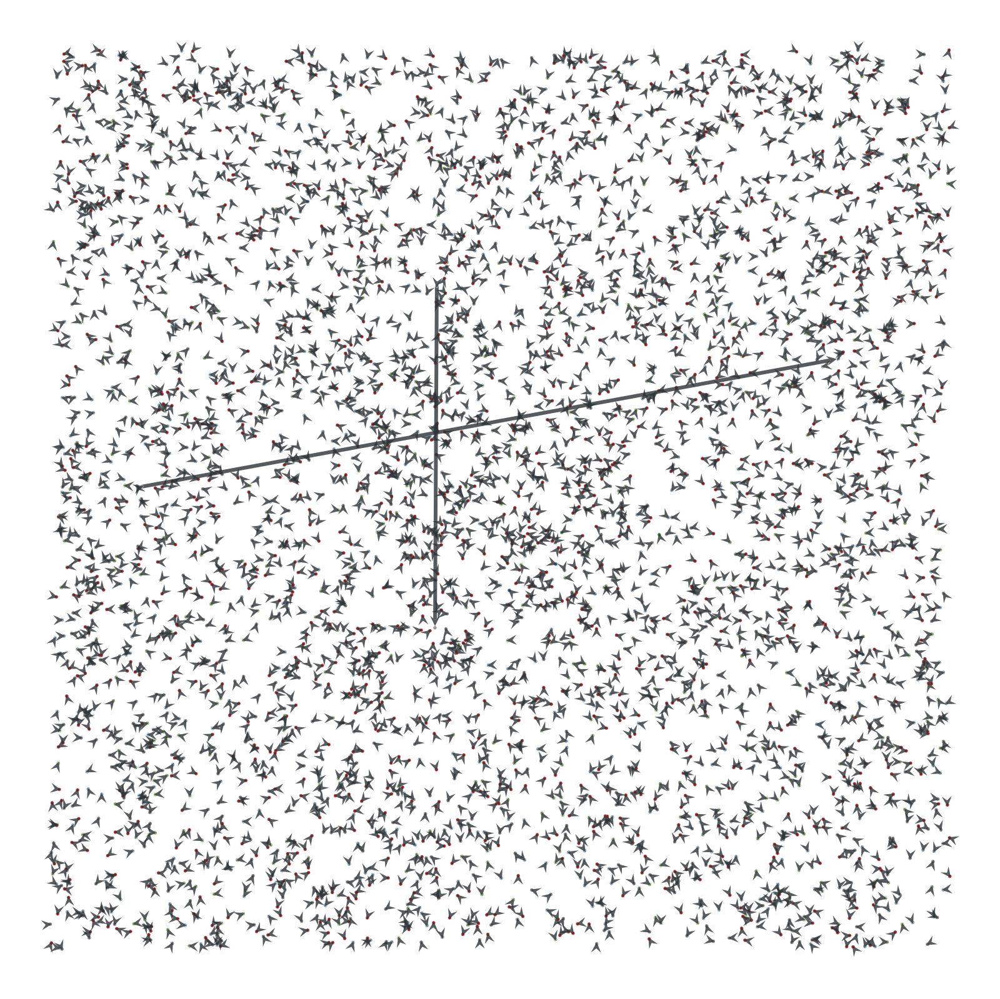

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x4a39fc590, at 0x3217503b0>

In [18]:
graph_draw(gv2, 
           output_size=(800,800),
           edge_pen_width=3.0,
           vertex_fill_color=gv2.vp['v_color_level'], nodesfirst=True)

If we wanted to, we could also colour this plot by the SL level. But in this case it probably isn't informative anway since they are so scattered.

In [19]:
#graph_draw(gv2, vertex_fill_color=search_res.vp['v_color_level'])

What we will do instead is plot the bipartite layout separated by each layer

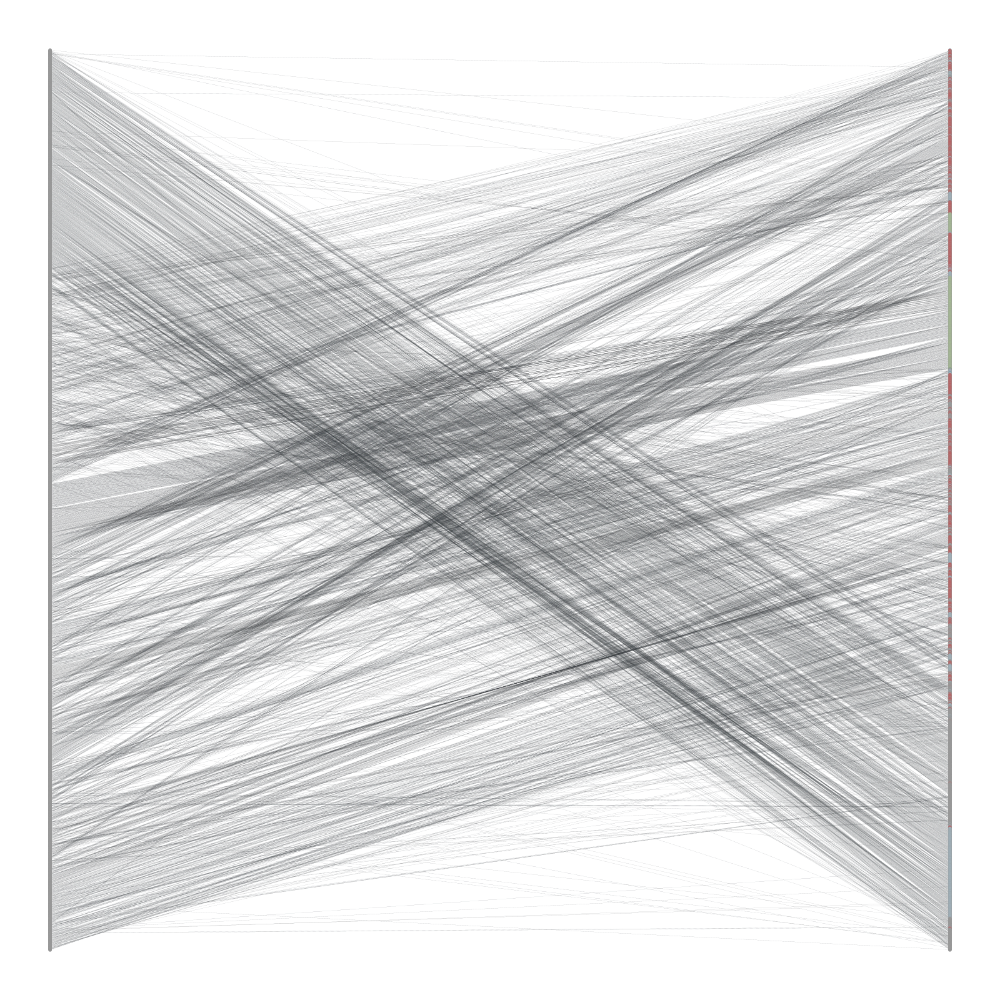

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x4a39fc590, at 0x1050e89e0>

In [20]:
# Example usage:
# Assume gv2 is your filtered GraphView and each vertex has a 'layer_decoded' property.
pos_by_layer = onionnet.visualisation.layout_by_layer(gv2, layer_prop_name='layer_decoded')
graph_draw(gv2,
              pos=pos_by_layer,
              output_size=(800, 800),
              edge_pen_width=.05,
              vertex_fill_color=gv2.vp['v_color_level'],
              nodesfirst=False)

This plot wasn't awfully informative in this case, because most of the connections between SL and ChEBI appear to have 1:1 relationships. But this in itself is still good to know, because prima facie it would appear there is little ambiguity in the mapping between these two type of formats.

Now let's try another layer

### PMID

In [21]:
layer_1 = 'swisslipids'
layer_2 = 'sl_pmid'
gv2 = onion.create_bipartite_gv(layer1=layer_1, layer2=layer_2)

In [22]:
pos_sfdp_pmid_bipartite = onionnet.visualisation.load_or_compute_layout(gv2, filename='.data/.explore_sl_pos_sfdp_pmid_bipartite.tsv')

Loaded layout for 5770 vertices from .data/.explore_sl_pos_sfdp_pmid_bipartite.tsv


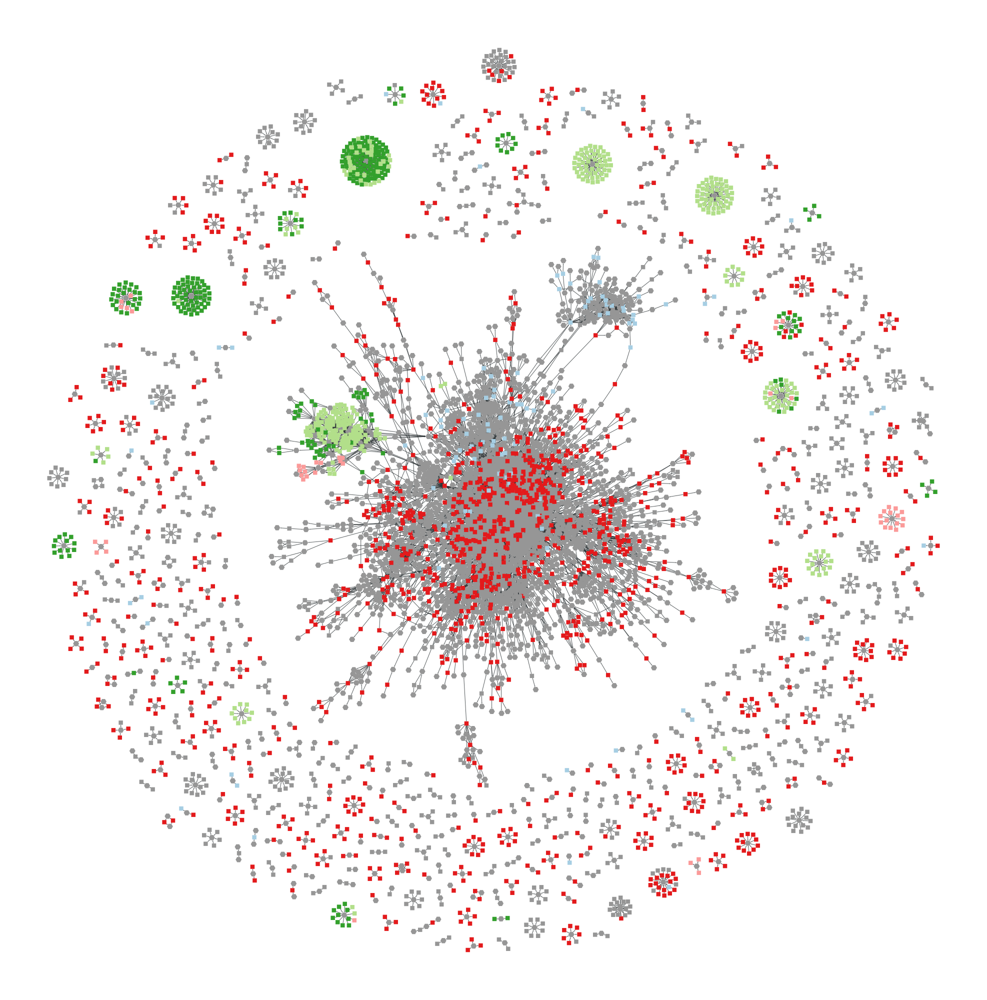

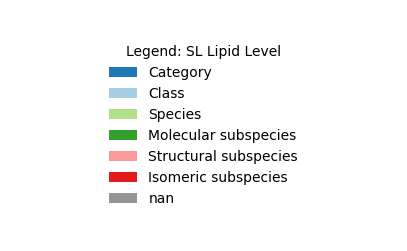

In [23]:
graph_draw(gv2, 
           vertex_size=6,
           vertex_pen_width=0,
           pos=pos_sfdp_pmid_bipartite,
           output_size=(1000,1000),
           edge_pen_width=0.5,
           vertex_fill_color=gv2.vp['v_color_level'], 
           vertex_shape=gv2.vp['v_shape_layer'],
           nodesfirst=False)

onionnet.visualisation.get_legend(source=graphic_styles['legend_node_color'], title='Legend: SL Lipid Level',
                                  ordered_cats=sl_levels_custom_order, save_filename='.data/explore_sl_pmid_to_sl_legend_cols')

Finally, an interesting finding visually from a network perspective, because we can see the relationships between the SL IDs and the PMIDs, being the published literature. This shows:

- __Some__ lipids have been __widely studied__ across the literature
- But __many lipids__ may be __understudied__ (plus those without PMID)
- Studies tend to be associated with lipids of the __same level__ (i.e. colour), probably due to shared experimental methods 
- Possible __bias__ towards annotations at class, species or isomeric levels

If we want to, we could also save a copy of this network to file as an SVG, with or without the text labels included too.

In [24]:
# temp_nodesize = 4
# temp_outsize = (800,800)
# include_text = False
# if include_text:
#     graph_draw(gv2, 
#             vertex_size=temp_nodesize,
#             output_size=temp_outsize,
#             vertex_pen_width=0,
#             pos=pos_sfdp_pmid_bipartite,
#             edge_pen_width=0.50,
#             vertex_fill_color=gv2.vp['v_color_level'], 
#             vertex_shape=gv2.vp['v_shape_layer'],
#             nodesfirst=False,
#             vertex_text=gv2.vp['node_id_decoded'],
#             vertex_text_position=-2,
#             vertex_text_color='black',
#             output='.data/explore_sl_network_pmid_to_sl_withtext.svg'
#             )
# else:
#     graph_draw(gv2, 
#             vertex_size=temp_nodesize,
#             output_size=temp_outsize,
#             vertex_pen_width=0,
#             pos=pos_sfdp_pmid_bipartite,
#             edge_pen_width=0.50,
#             vertex_fill_color=gv2.vp['v_color_level'], 
#             vertex_shape=gv2.vp['v_shape_layer'],
#             nodesfirst=False,
#             output='network_pmid_to_sl.svg'
#             )

Again we can create another bipartite network to inspect this.

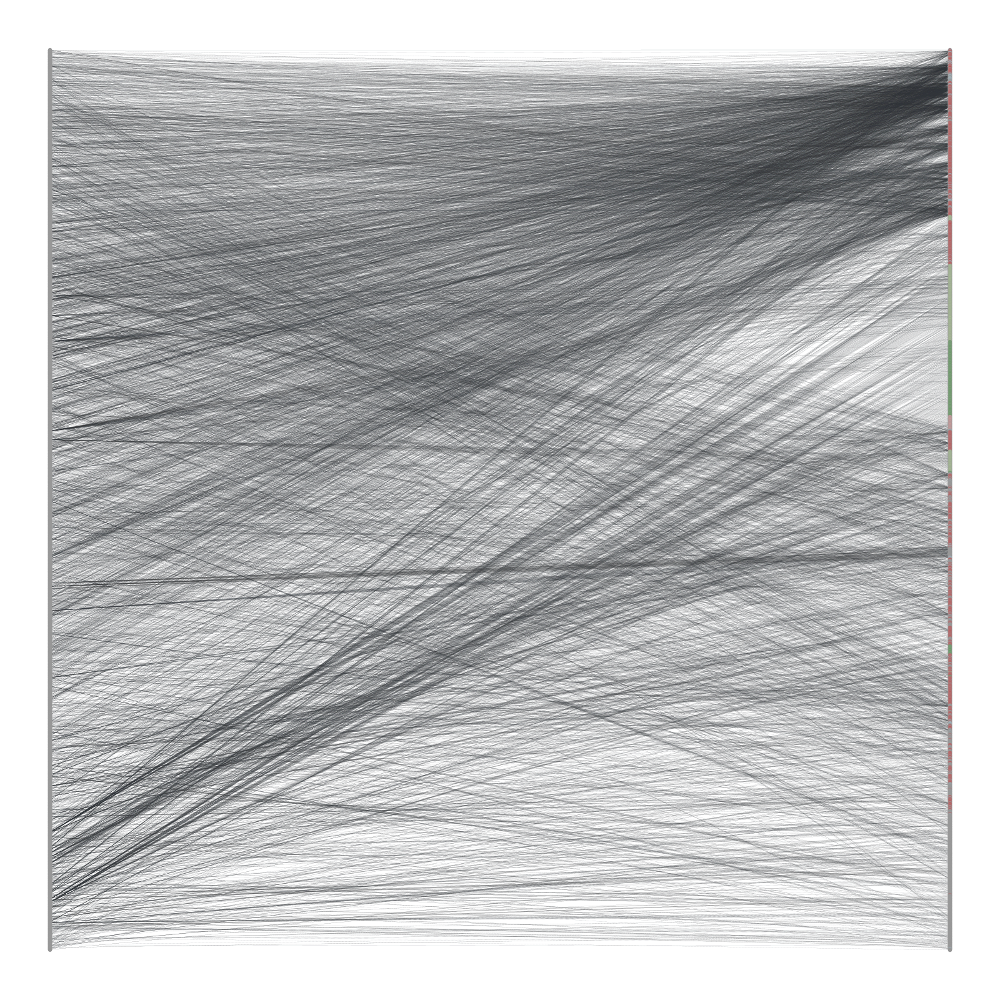

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x169483dd0, at 0x43cf239e0>

In [25]:
# gv2 is the filtered GraphView and each vertex has a 'layer_decoded' property.
pos_by_layer = onionnet.visualisation.layout_by_layer(gv2, layer_prop_name='layer_decoded', spacing=50)
graph_draw(gv2,
              pos=pos_by_layer,
              output_size=(800, 800),
              edge_pen_width=.05,
              vertex_fill_color=gv2.vp['v_color_level'],
              nodesfirst=False)

This seems to show some lipid nodes with a very high number of connections to the publications, like we saw in the first network plot. But to get a better indication of this we will increase the node sizes, switch their location to the left-handside, and sort them into their classes.

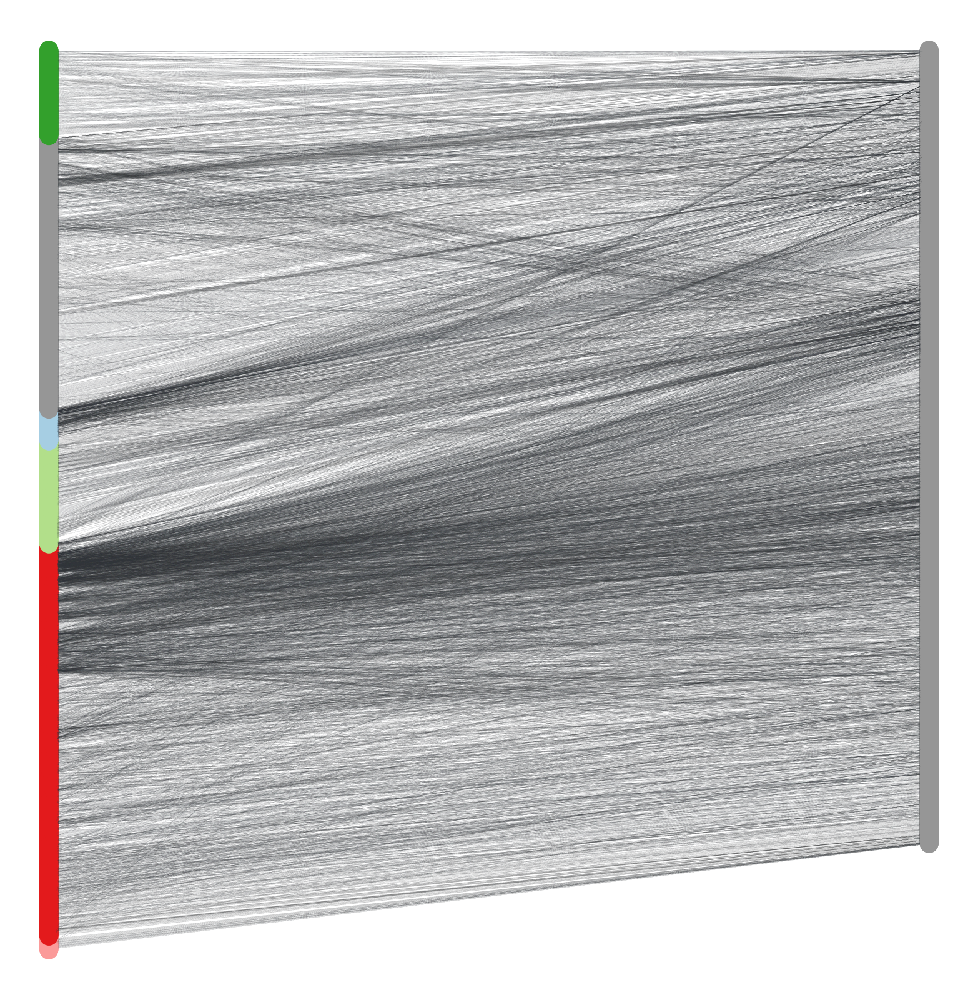

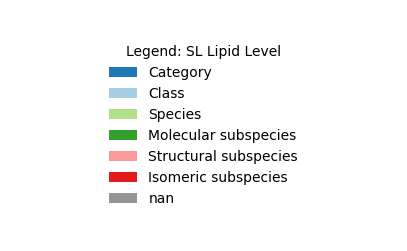

In [26]:
pos_ord_bipartite = onionnet.visualisation.bipartite_ordered_layout(
    gv2,
    layer_prop='layer_decoded',
    left_val=layer_1,
    right_val=layer_2,
    vertical_spacing=2.0, 
    horizontal_spacing=6000.0,
    sort_left_by=lambda v: tuple(gv2.vp['v_color_level'][v])
)

graph_draw(gv2,
              pos=pos_ord_bipartite,
              output_size=(800, 800),
              edge_pen_width=.05,
              vertex_fill_color=gv2.vp['v_color_level'],
              nodesfirst=True,
              vertex_pen_width=0,
              vertex_size=15)

onionnet.visualisation.get_legend(source=graphic_styles['legend_node_color'], title='Legend: SL Lipid Level')

From this we can now see that many of the nodes with the most connections to the literature are of the `Isomeric subspecies` level, and to a slightly lesser extent, in the `Class` level. So the most well studied lipids seem to be at these levels, at least qualitatively. 

In contrast, we can see that many of the lipids in the `Species` class have come from a very small number of papers.

### HMDB

In [27]:
layer_1 = 'swisslipids'
layer_2 = 'sl_hmdb'
gv2 = onion.create_bipartite_gv(layer1=layer_1, layer2=layer_2)

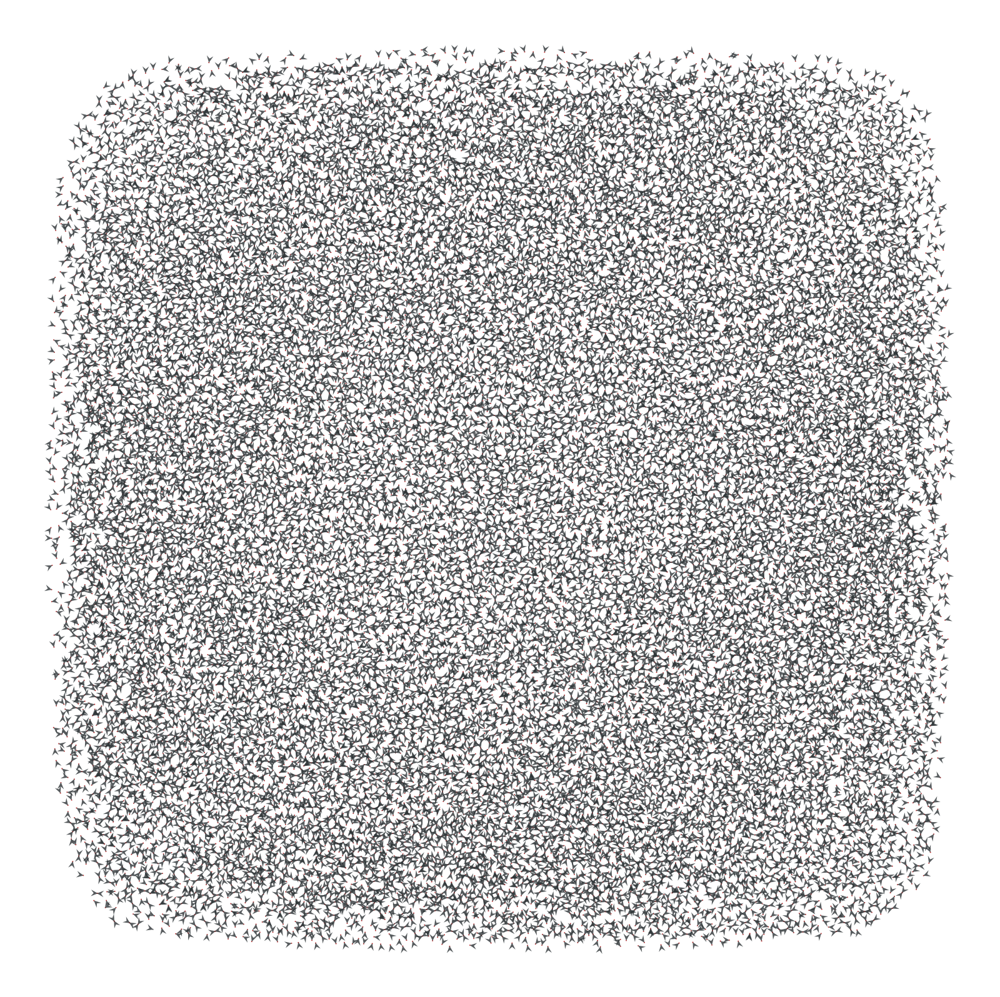

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x391299d00, at 0x3912cade0>

In [28]:
graph_draw(gv2, 
           output_size=(800,800),
           edge_pen_width=2.0,
           vertex_fill_color=gv2.vp['v_color_level'], 
           vertex_shape=gv2.vp['v_shape_layer'],
           nodesfirst=True)

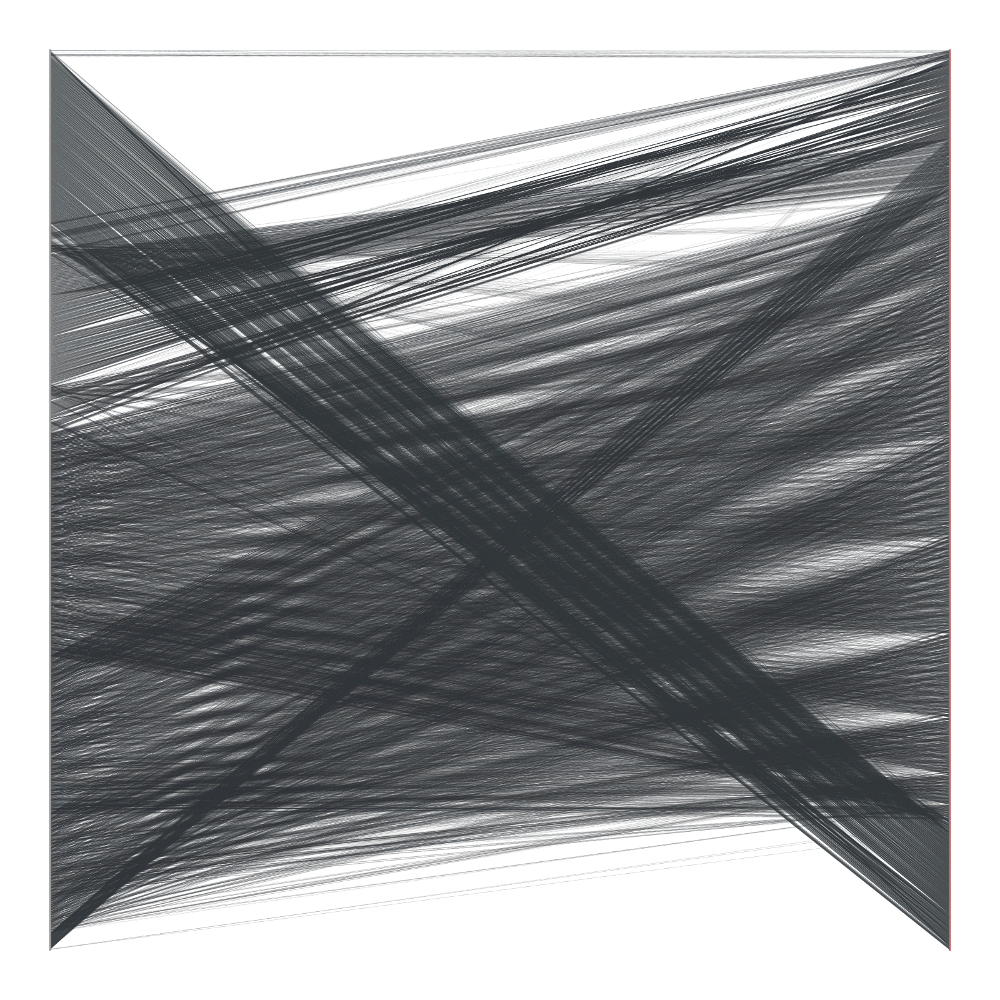

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x391299d00, at 0x43cf5ed50>

In [29]:
pos_by_layer = onionnet.visualisation.layout_by_layer(gv2, layer_prop_name='layer_decoded')
graph_draw(gv2,
              pos=pos_by_layer,
              output_size=(800, 800),
              edge_pen_width=.05,
              vertex_fill_color=gv2.vp['v_color_level'],
              nodesfirst=False)

### LipidMaps

In [30]:
layer_1 = 'swisslipids'
layer_2 = 'sl_lipidmaps'
gv = onion.create_bipartite_gv(layer1=layer_1, layer2=layer_2)
gv

<GraphView object, directed, with 24229 vertices and 12117 edges, 45 internal vertex properties, 7 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x39127a960, at 0x43cf5df40>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x39127a960, at 0x3217de600>, False), at 0x39127a960>

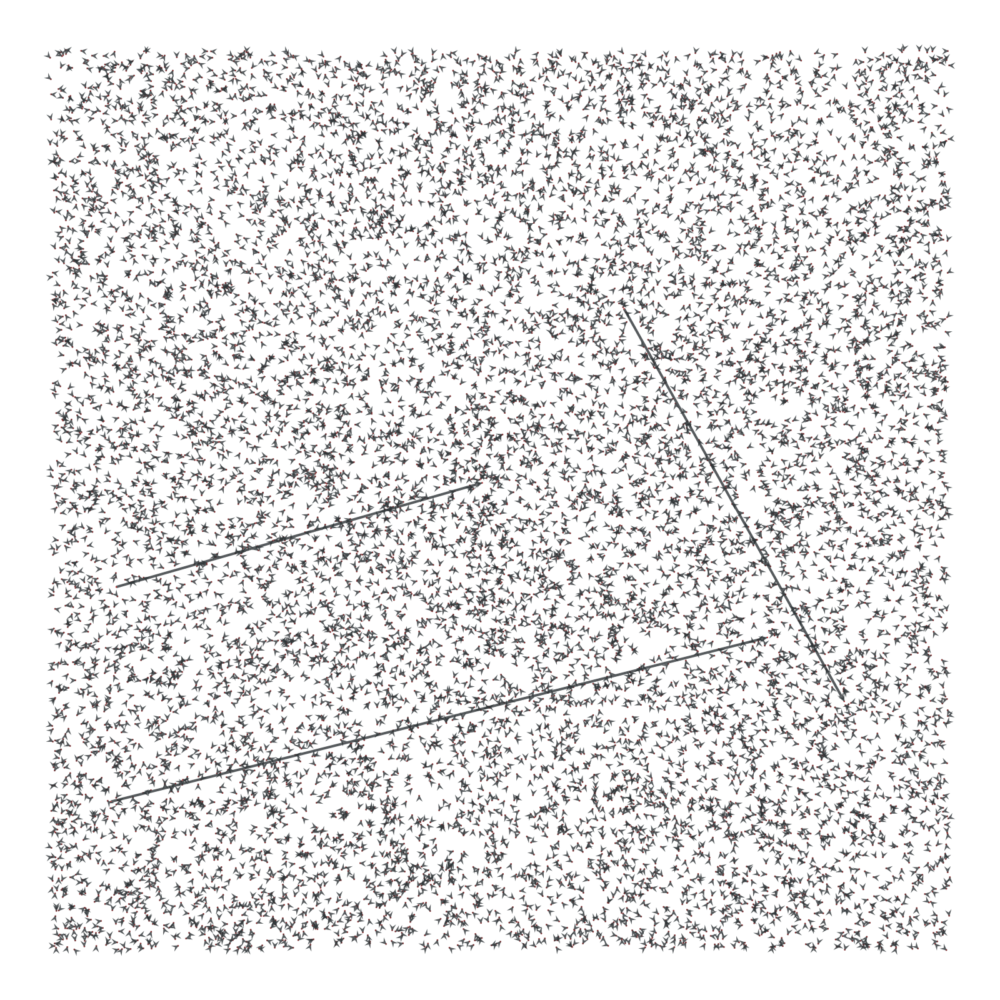

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x39127a960, at 0x43cf5f0e0>

In [31]:
graph_draw(gv, 
           output_size=(800,800),
           edge_pen_width=2.0,
           vertex_fill_color=gv.vp['v_color_level'], 
           vertex_shape=gv.vp['v_shape_layer'],
           nodesfirst=True)

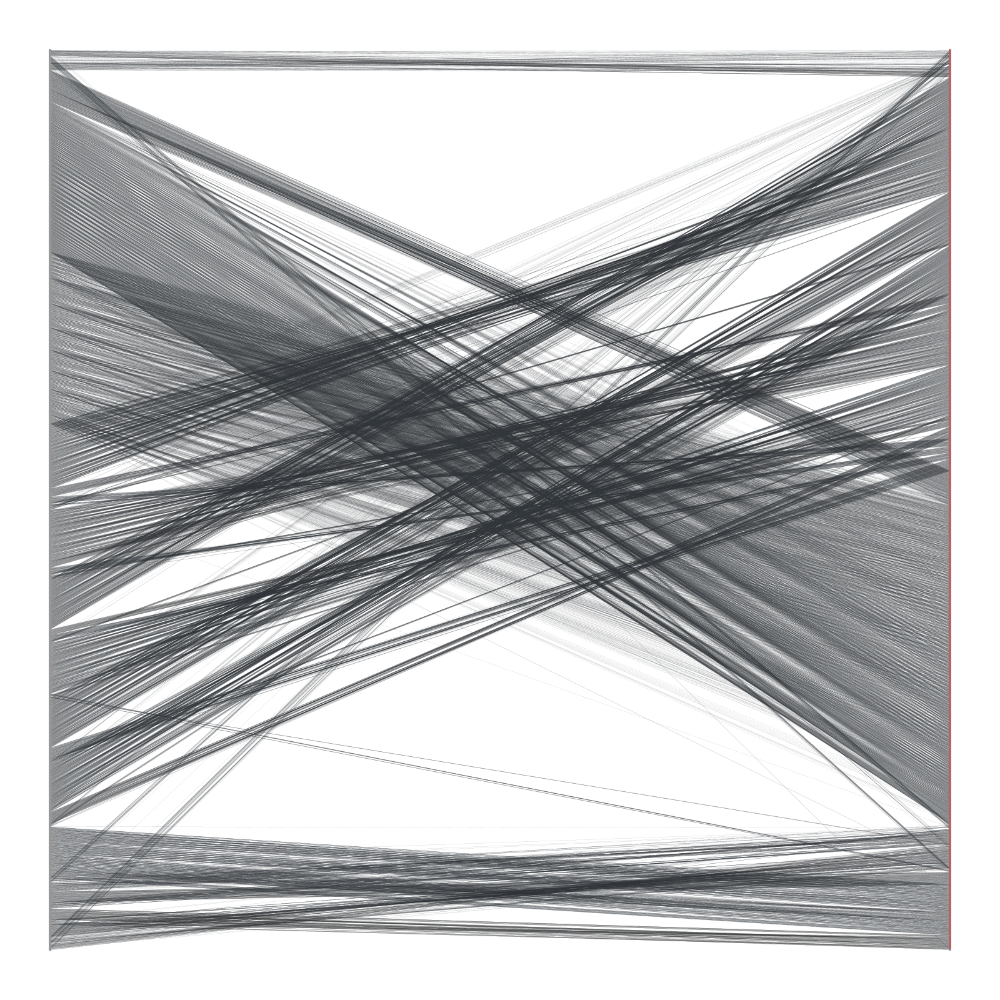

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x39127a960, at 0x3065891f0>

In [32]:
pos_by_layer = onionnet.visualisation.layout_by_layer(gv, layer_prop_name='layer_decoded')
graph_draw(gv,
              pos=pos_by_layer,
              output_size=(800, 800),
              edge_pen_width=.05,
              vertex_fill_color=gv.vp['v_color_level'],
              nodesfirst=False)

### SL Components (parsed)

In [33]:
layer_1 = 'swisslipids'
layer_2 = 'sl_components_parsed'
gv = onion.create_bipartite_gv(layer1=layer_1, layer2=layer_2)
gv

<GraphView object, directed, with 767000 vertices and 1852844 edges, 45 internal vertex properties, 7 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x4a39fdca0, at 0x43cf1c890>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x4a39fdca0, at 0x39127ad80>, False), at 0x4a39fdca0>

In [34]:
deg = gv.degree_property_map('in')
pd.Series(deg).value_counts()

0        765323
1           623
4            74
474          69
30           67
2            64
70           64
12           63
6            55
21           51
7            51
20           45
11           37
29           33
9            30
39           29
7263         29
15439        29
5617         28
2350         25
10           25
42           18
6114         17
3473         16
17           16
486          13
31456        12
19           12
410          12
13           10
32            9
16            9
7311          8
45            8
31492         8
14            4
5629          4
36            1
6531          1
6113          1
473           1
15475         1
469           1
5             1
475           1
15438         1
3383          1
Name: count, dtype: int64

We won't visualise this, because it would be far too large.

### SL Synonyms

In [35]:
layer_1 = 'swisslipids'
layer_2 = 'sl_synonyms'
gv = onion.create_bipartite_gv(layer1=layer_1, layer2=layer_2)
gv

<GraphView object, directed, with 1083210 vertices and 568258 edges, 45 internal vertex properties, 7 internal edge properties, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x39127b740, at 0x3912fe3f0>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x39127b740, at 0x3912fee70>, False), at 0x39127b740>

We won't visualise this, because it would be far too large.

But we can inspect the in- and out-degree of the nodes to identify what the most commonly shared synonyms are for the lipids and their identifiers, thereby identifying which have ambiguities.

First we will consider the 'in' degree of the nodes. Since the SL IDs point towards the synonyms, this will indicate the distribution of synonyms that are shared with others.

In [36]:
# Compute in-degree centrality
deg = gv.degree_property_map('in')
pd.Series(deg).value_counts()

0    548163
1    504991
2     28517
4      1467
3        38
8        27
5         7
Name: count, dtype: int64

We can now get all synonyms that, for instance, are mapped to 5 or more SL IDs.

In [37]:
[gv.vp['node_id_decoded'][v] for v in gv.vertices() if gv.vp['layer_decoded'][v] == 'sl_synonyms' and v.in_degree() > 4]

['Diacylglycerol (O-)',
 'Lysophosphatidate',
 'Lysophosphatidylcholine',
 'Lysophosphatidylethanolamine',
 'Lysophosphatidylglycerol',
 'Lysophosphatidylinositol',
 'Lysophosphatidylserine',
 'Triacylglycerol (13:0/13:0/13:0)',
 'Triacylglycerol (13:0/13:0/15:0)',
 'Triacylglycerol (13:0/13:0/17:0)',
 'Triacylglycerol (13:0/15:0/13:0)',
 'Triacylglycerol (13:0/15:0/15:0)',
 'Triacylglycerol (13:0/15:0/17:0)',
 'Triacylglycerol (13:0/17:0/13:0)',
 'Triacylglycerol (13:0/17:0/15:0)',
 'Triacylglycerol (13:0/17:0/17:0)',
 'Triacylglycerol (15:0/13:0/13:0)',
 'Triacylglycerol (15:0/13:0/15:0)',
 'Triacylglycerol (15:0/13:0/17:0)',
 'Triacylglycerol (15:0/15:0/13:0)',
 'Triacylglycerol (15:0/15:0/15:0)',
 'Triacylglycerol (15:0/15:0/17:0)',
 'Triacylglycerol (15:0/17:0/13:0)',
 'Triacylglycerol (15:0/17:0/15:0)',
 'Triacylglycerol (15:0/17:0/17:0)',
 'Triacylglycerol (17:0/13:0/13:0)',
 'Triacylglycerol (17:0/13:0/15:0)',
 'Triacylglycerol (17:0/13:0/17:0)',
 'Triacylglycerol (17:0/15:0/13

Now we can also consider which SL IDs have the highest number of synonyms linked to them

In [38]:
# Compute in-degree centrality
deg = gv.degree_property_map('out')
pd.Series(deg).value_counts()

0    535047
1    528310
2     19619
3       227
4         6
5         1
Name: count, dtype: int64

In [39]:
[gv.vp['node_id_decoded'][v] for v in gv.vertices() if gv.vp['layer_decoded'][v] == 'swisslipids' and v.out_degree() > 3]

['SLM:000508891',
 'SLM:000508893',
 'SLM:000508950',
 'SLM:000509166',
 'SLM:000509167',
 'SLM:000509168',
 'SLM:000509169']